[![image](https://raw.githubusercontent.com/visual-layer/visuallayer/main/imgs/vl_horizontal_logo.png)](https://www.visual-layer.com)

# Analyzing Kaggle Datasets

[![Open in Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/visual-layer/fastdup/blob/main/examples/analyzing-kaggle-datasets.ipynb)
[![Open in Kaggle](https://kaggle.com/static/images/open-in-kaggle.svg)](https://kaggle.com/kernels/welcome?src=https://github.com/visual-layer/fastdup/blob/main/examples/analyzing-kaggle-datasets.ipynb)

This notebook shows how you can use [fastdup](https://github.com/visual-layer/fastdup) to analyze any computer vision dataset from [Kaggle](https://kaggle.com).

## Install Kaggle API

To load data programmatically from Kaggle, we will need to install the [Kaggle API](https://github.com/Kaggle/kaggle-api). The API lets us pull data from Kaggle using Python.

To install the API, run:

In [1]:
!pip install -Uq kaggle

Note: to use the Kaggle API, you'll need to sign up for a Kaggle account at https://www.kaggle.com/ . 

Go to the 'Account' tab and select 'Create API Token'. This will trigger the download of `kaggle.json`, a file containing your API credentials. 

Place this file in the location `~/.kaggle/kaggle.json` (on Windows in the location `C:\Users\<Windows-username>\.kaggle\kaggle.json`)

Fore more information on the Kaggle API, click [here](https://github.com/Kaggle/kaggle-api#api-credentials).

If the set up is done correctly, you should be able to run the kaggle commands on your terminal. For instance, to list kaggle datasets that have the term "computer vision" , run:

In [2]:
!kaggle datasets list -s "computer vision"

ref                                                           title                                                size  lastUpdated          downloadCount  voteCount  usabilityRating  
------------------------------------------------------------  --------------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
jeffheaton/iris-computer-vision                               Iris Computer Vision                                  5MB  2020-11-24 21:23:29           1415         20  0.875            
bhavikardeshna/visual-question-answering-computer-vision-nlp  Visual Question Answering- Computer Vision & NLP    411MB  2022-06-14 04:32:28            421         37  0.8235294        
sanikamal/horses-or-humans-dataset                            Horses Or Humans Dataset                            307MB  2019-04-24 20:09:38           8405        120  0.875            
phylake1337/fire-dataset                                      FIRE Dat

See more commands [here](https://github.com/Kaggle/kaggle-api#commands). 

Optionally, you can also browse the Kaggle webpage to see the dataset you're interested to download.

## Download Dataset

Let's say we're interested to analyze the [RVL-CDIP Test Dataset](https://www.kaggle.com/datasets/pdavpoojan/the-rvlcdip-dataset-test). You can head to the dataset page and click on "Copy API command" and paste it in your terminal.

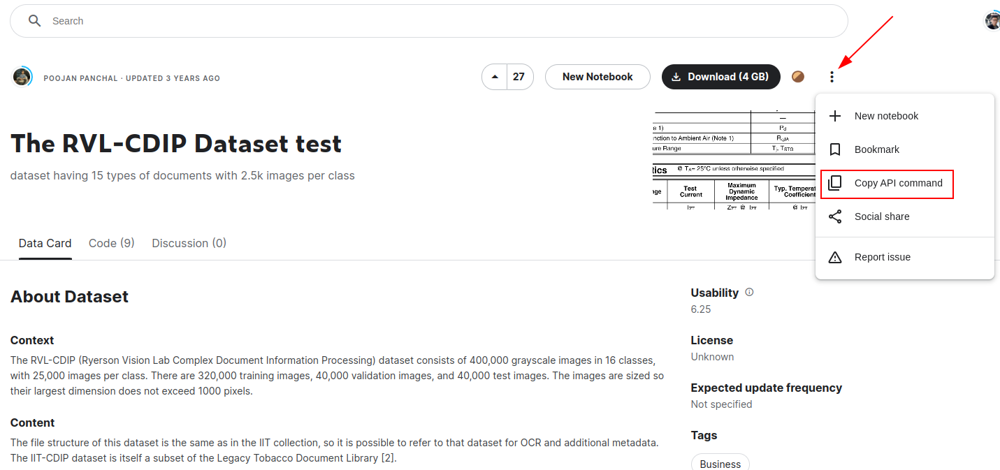

Let's run the command here, which will trigger a download of the RVL-CDIP test dataset into our current working directory.

In [ ]:
!kaggle datasets download -d pdavpoojan/the-rvlcdip-dataset-test

Once done, we should have a `the-rvlcdip-dataset-test.zip` in the current directory.

Let's unzip the file to prepare it for further analysis with fastdup in the next section.

In [3]:
!unzip -q the-rvlcdip-dataset-test.zip

Once completed, we should have a folder with the name `test/`, which contains all the images from the dataset.

## Install fastdup

Next, install fastdup and verify the installation.

In [4]:
!pip install -Uq fastdup 

Now, test the installation. If there's no error message, we are ready to go.

In [5]:
import fastdup
fastdup.__version__

/usr/bin/dpkg


'1.31'

## Run fastdup

To run fastdup, we simply point `input_dir` to the folder containing the images from the dataset.

In [6]:
fd = fastdup.create(input_dir='test')
fd.run()

FastDup Software, (C) copyright 2022 Dr. Amir Alush and Dr. Danny Bickson.
2023-08-01 14:04:04 [INFO] Going to loop over dir test
2023-08-01 14:04:04 [INFO] Found total 39997 images to run on, 39997 train, 0 test, name list 39997, counter 39997 
2023-08-01 14:05:22 [ERROR] Failed to read image test/scientific_publication/2500126531_2500126536.tif
2023-08-01 14:05:37 [INFO] Found total 39997 images to run onimated: 0 Minutes
Finished histogram 12.923
Finished bucket sort 12.997
2023-08-01 14:05:41 [INFO] 4180) Finished write_index() NN model
2023-08-01 14:05:41 [INFO] Stored nn model index file work_dir/nnf.index
2023-08-01 14:05:44 [INFO] Total time took 100130 ms
2023-08-01 14:05:44 [INFO] Found a total of 1392 fully identical images (d>0.990), which are 1.74 %
2023-08-01 14:05:44 [INFO] Found a total of 10177 nearly identical images(d>0.980), which are 12.72 %
2023-08-01 14:05:44 [INFO] Found a total of 73590 above threshold images (d>0.900), which are 91.99 %
2023-08-01 14:05:44 [IN

0

## Inspect Issues

From the summary above, we have 1 corrupted image. Let's get some more details:

In [7]:
fd.invalid_instances()

,filename,index,error_code,is_valid,fd_index
0,test/scientific_publication/2500126531_2500126536.tif,33760,ERROR_CORRUPT_IMAGE,False,33760


There are several other methods we can use to inspect and visualize the issues found:

```python
fd.vis.duplicates_gallery()    # create a visual gallery of duplicates
fd.vis.outliers_gallery()      # create a visual gallery of anomalies
fd.vis.component_gallery()     # create a visualization of connected components
fd.vis.stats_gallery()         # create a visualization of images statistics (e.g. blur)
fd.vis.similarity_gallery()    # create a gallery of similar images
```

100%|█████████████████████████████████| 20/20 [00:00<00:00, 246.94it/s]


Stored similarity visual view in  work_dir/galleries/duplicates.html
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



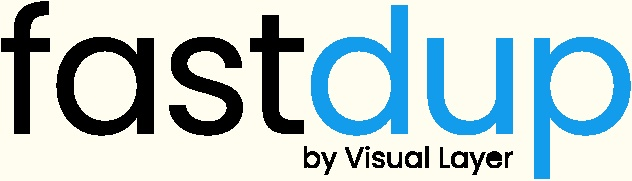
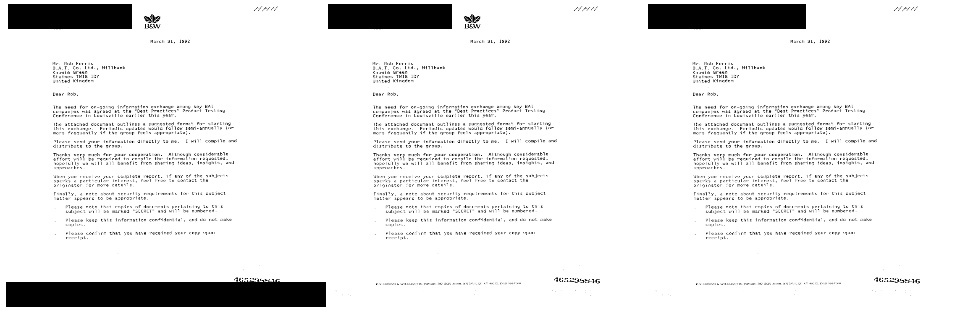
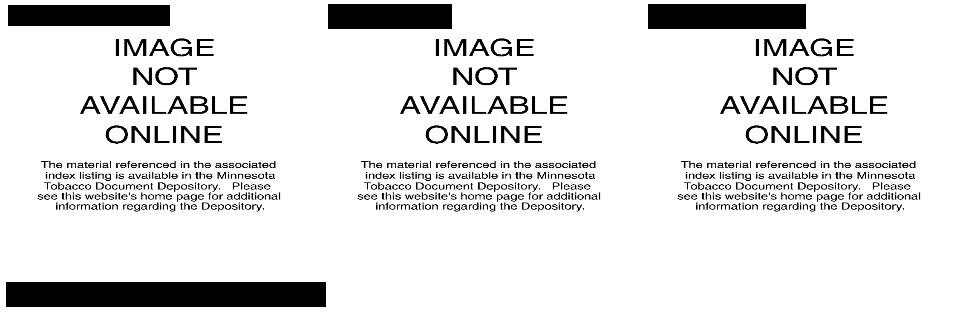
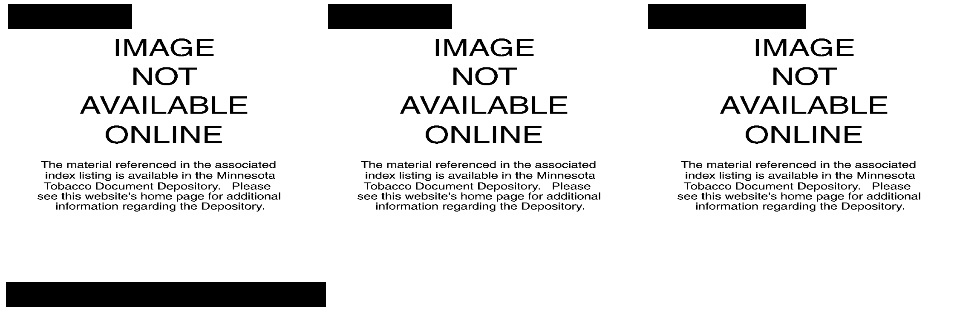
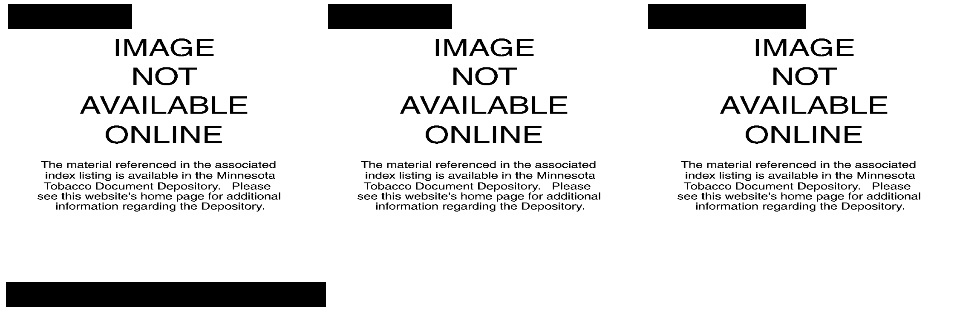
...
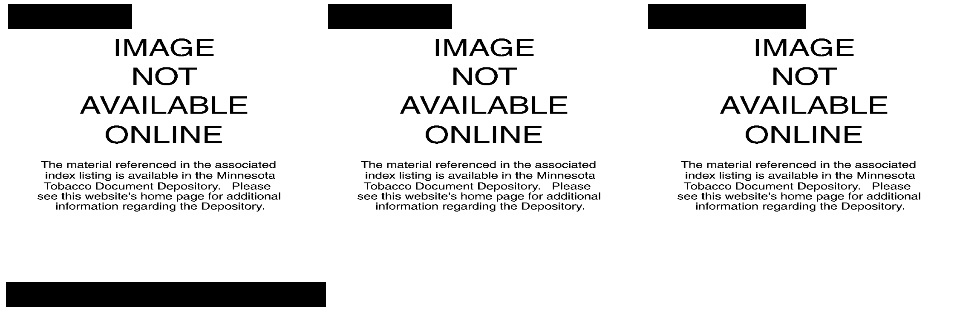
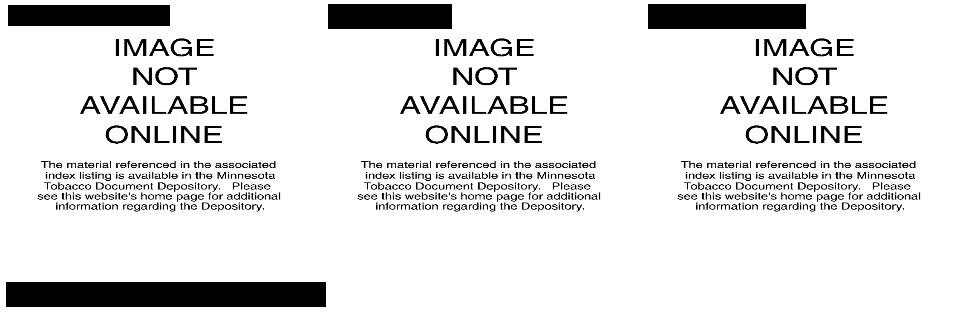
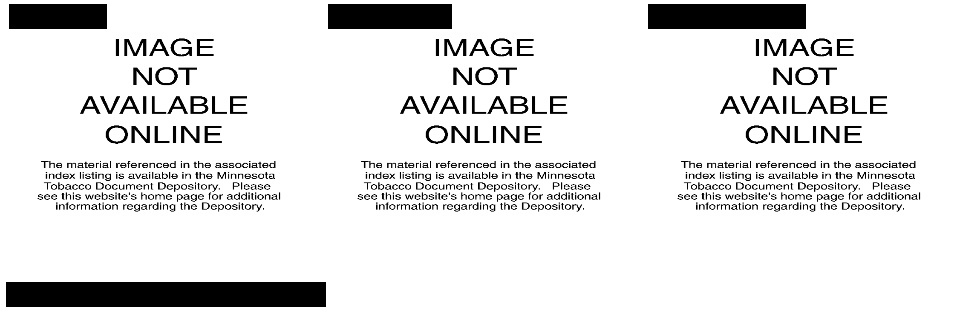
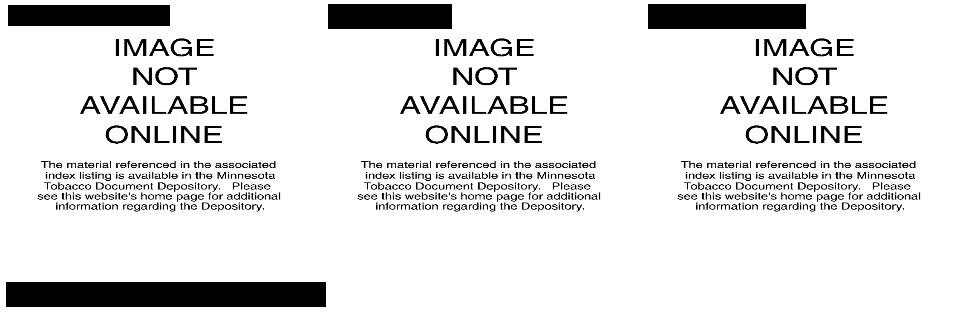
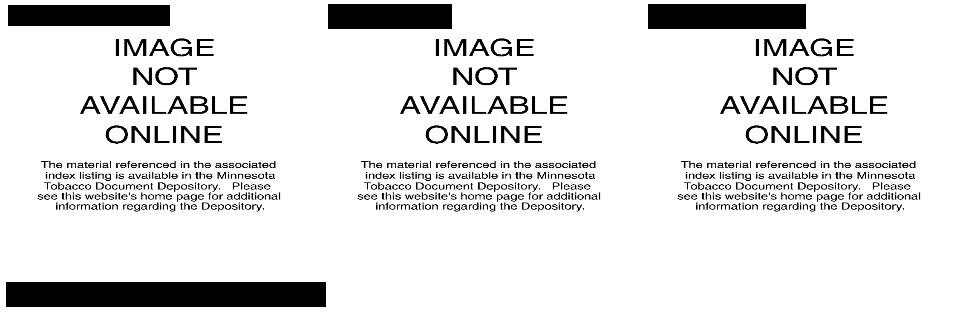

0

In [8]:
fd.vis.duplicates_gallery()

100%|██████████████████████████████████| 20/20 [00:02<00:00,  9.53it/s]


Finished OK. Components are stored as image files work_dir/galleries/components_[index].jpg
Stored components visual view in  work_dir/galleries/components.html
Execution time in seconds 4.2
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



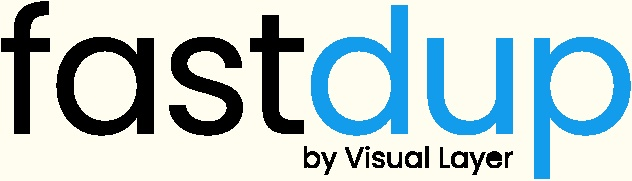
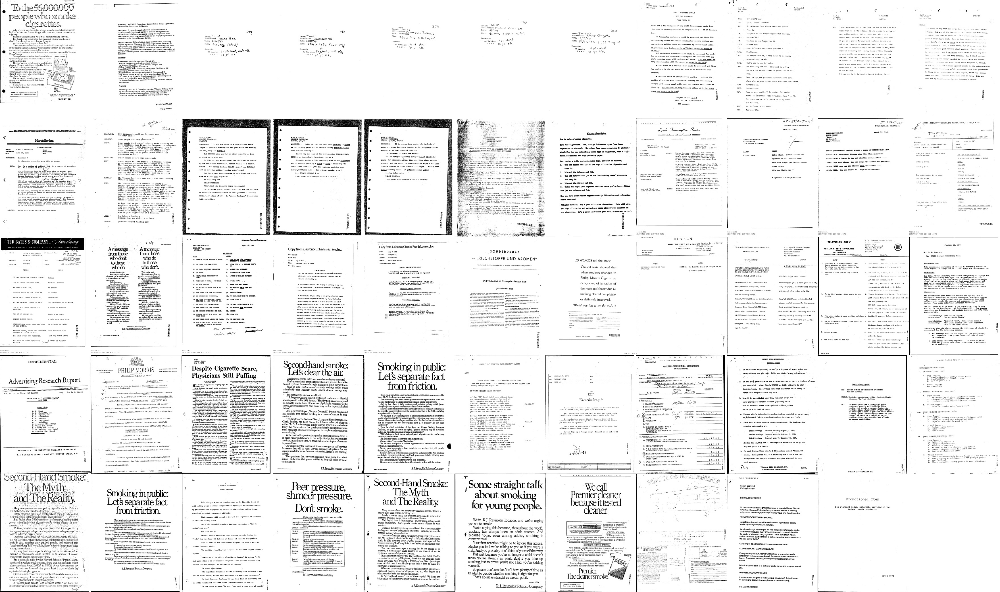
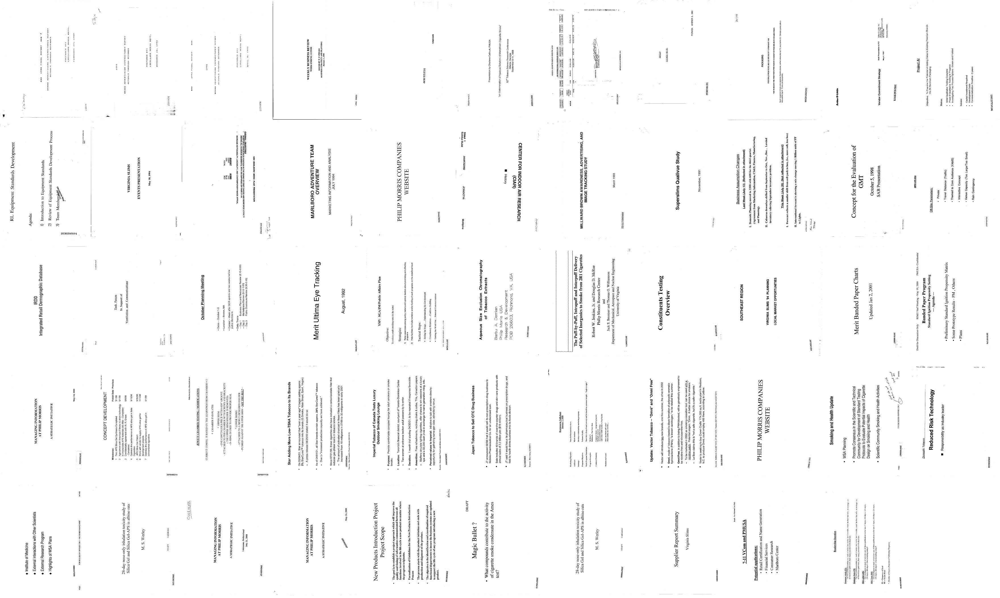
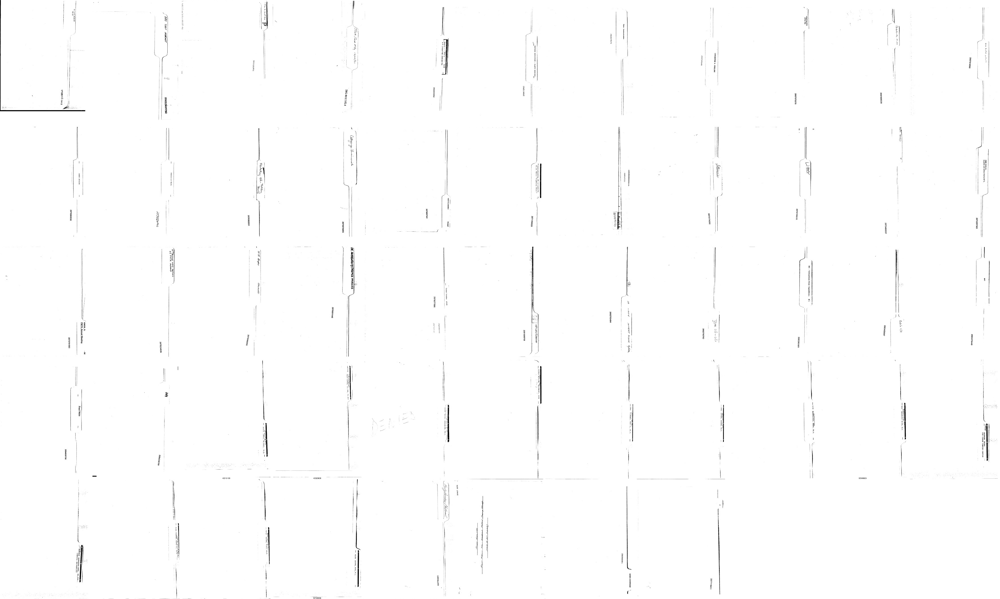
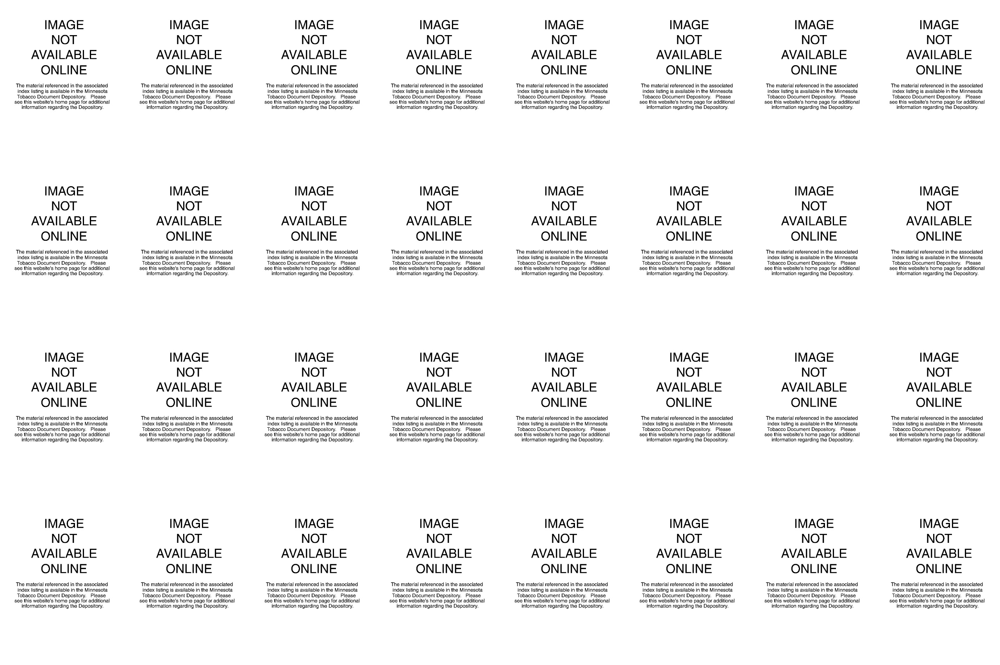
...
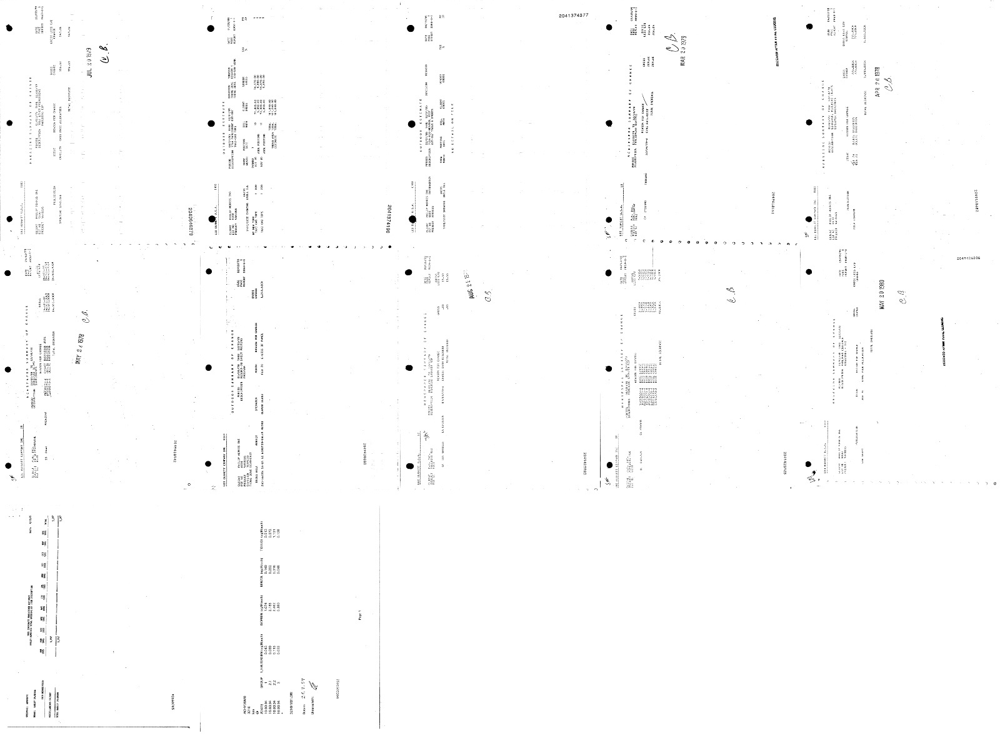
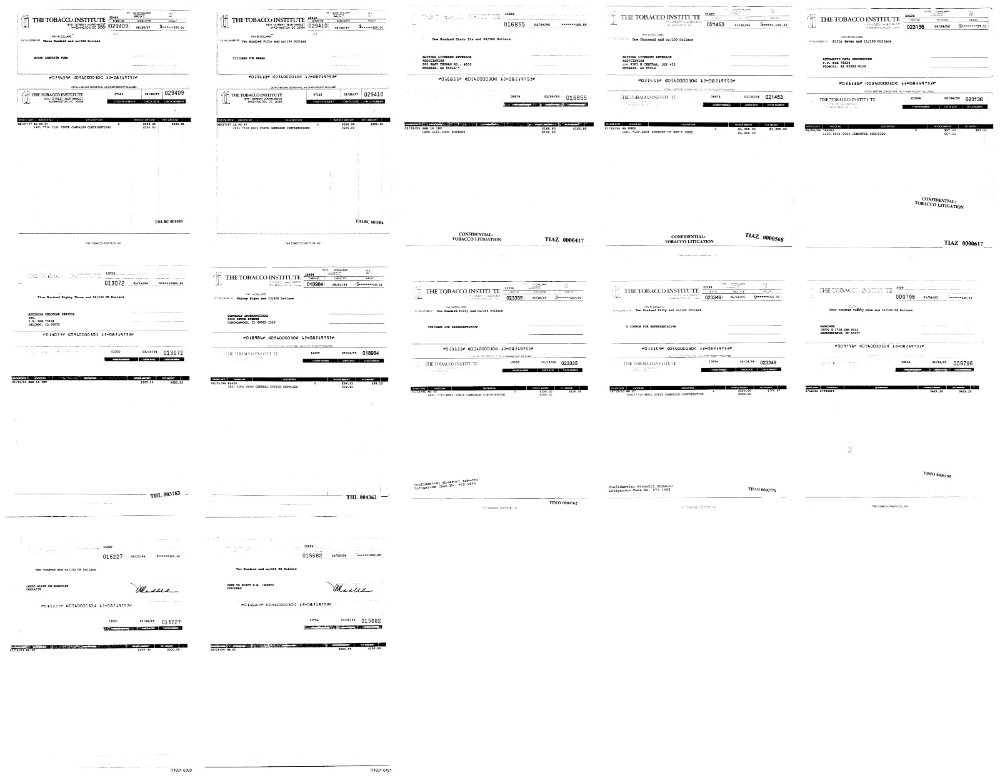
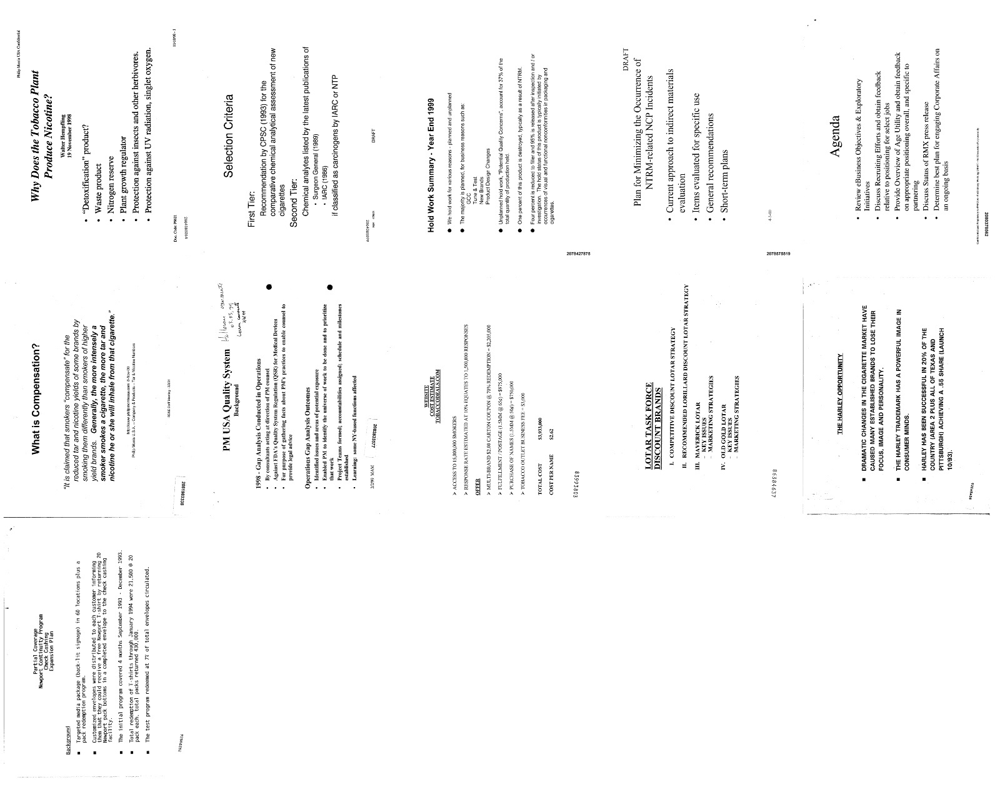
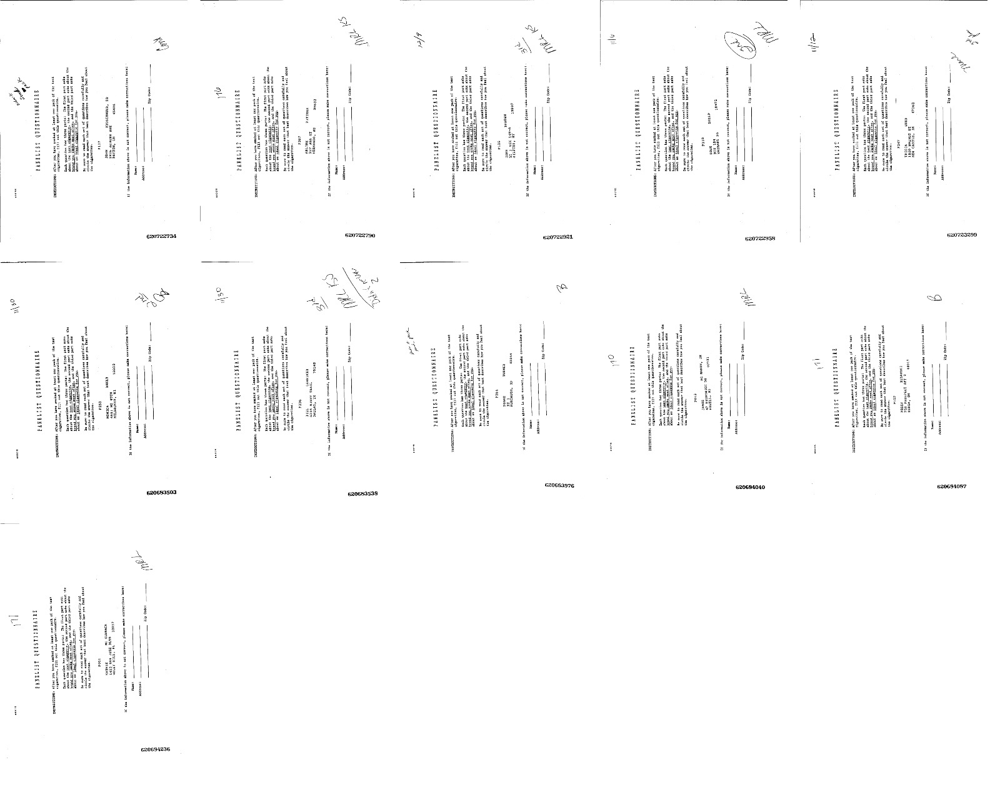
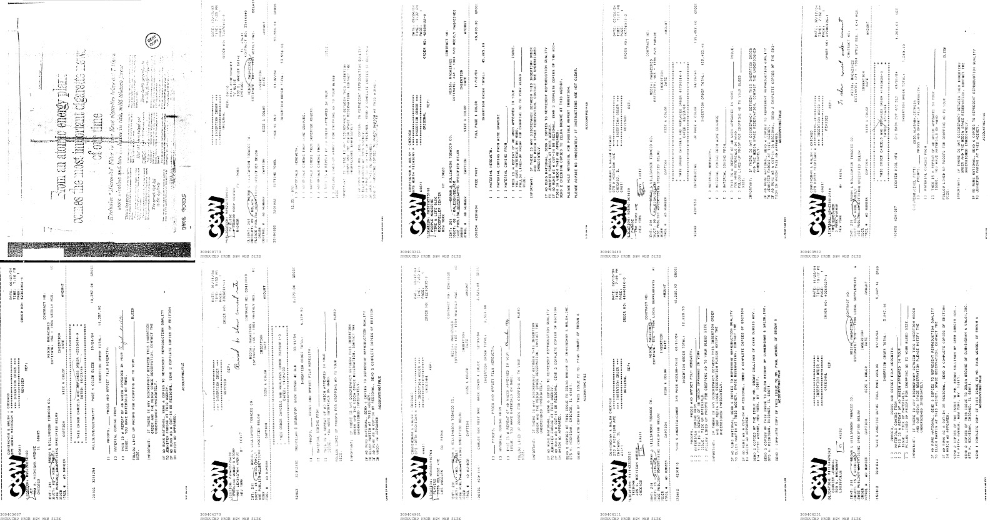

0

In [9]:
fd.vis.component_gallery()

100%|█████████████████████████████████| 20/20 [00:00<00:00, 610.40it/s]

Stored mean visual view in  work_dir/galleries/mean.html
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



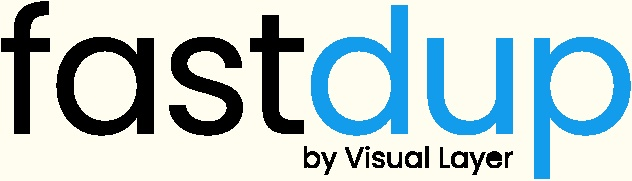
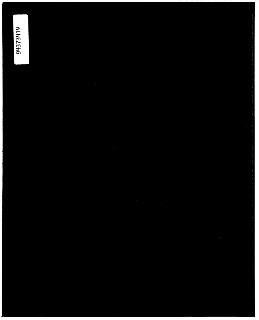
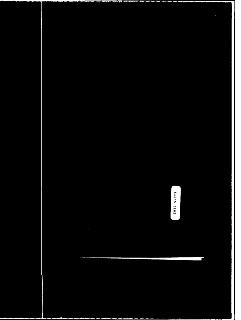
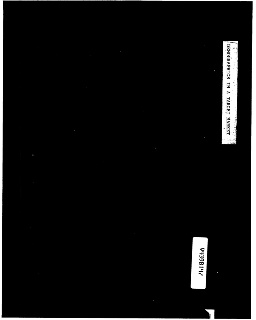
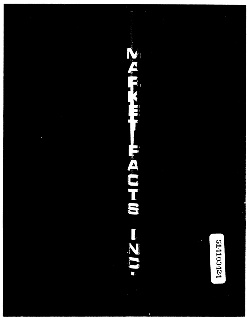
...
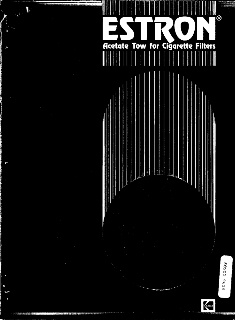
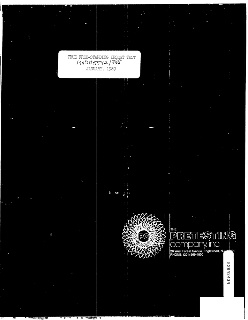
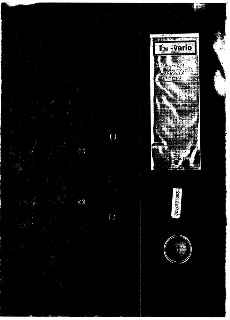
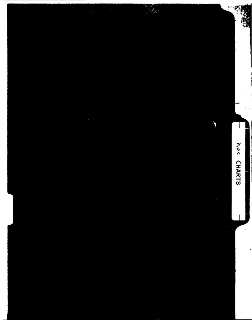
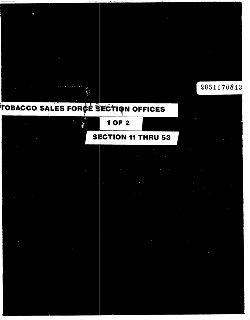

0

In [11]:
fd.vis.stats_gallery(metric='dark')

100%|█████████████████████████████████| 20/20 [00:00<00:00, 714.02it/s]

Stored mean visual view in  work_dir/galleries/mean.html
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



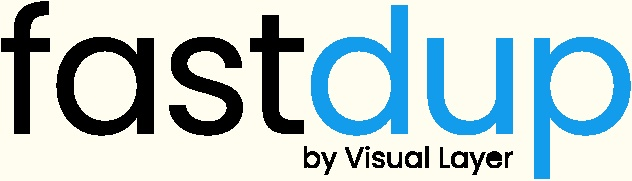
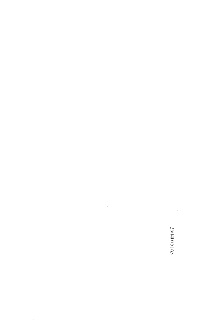
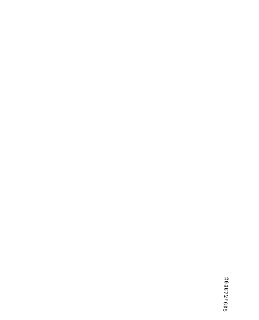
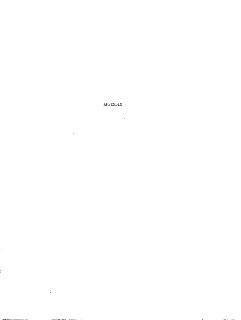
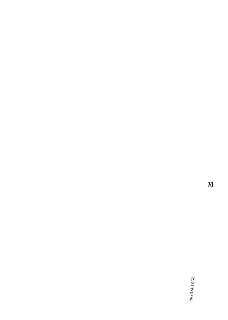
...
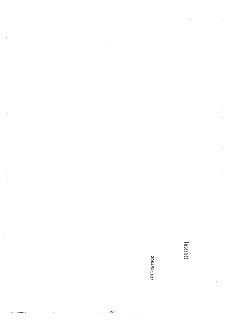
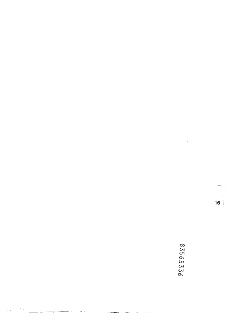
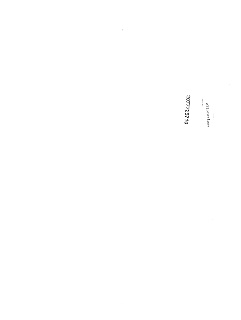
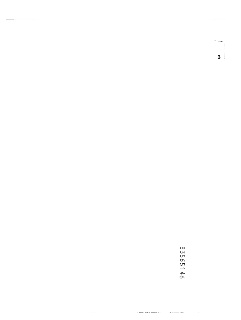
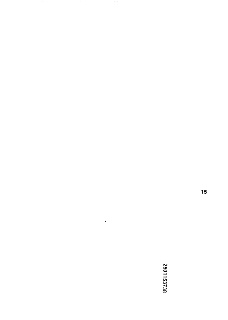

0

In [12]:
fd.vis.stats_gallery(metric='bright')

## Wrap Up

That's a wrap! In this notebook we showed how you load dataset from Kaggle and analyze it using fastdup. You can use similar methods to run on other similar datasets on [Kaggle](https://kaggle.com).

Try it out and let us know what issues you find.


Next, feel free to check out other tutorials -

+ ⚡ [**Quickstart**](https://nbviewer.org/github/visual-layer/fastdup/blob/main/examples/quick-dataset-analysis.ipynb): Learn how to install fastdup, load a dataset and analyze it for potential issues such as duplicates/near-duplicates, broken images, outliers, dark/bright/blurry images, and view visually similar image clusters. If you're new, start here!
+ 🧹 [**Clean Image Folder**](https://nbviewer.org/github/visual-layer/fastdup/blob/main/examples/cleaning-image-dataset.ipynb): Learn how to analyze and clean a folder of images from potential issues and export a list of problematic files for further action. If you have an unorganized folder of images, this is a good place to start.
+ 🖼 [**Analyze Image Classification Dataset**](https://nbviewer.org/github/visual-layer/fastdup/blob/main/examples/analyzing-image-classification-dataset.ipynb): Learn how to load a labeled image classification dataset and analyze for potential issues. If you have labeled ImageNet-style folder structure, have a go!
+ 🎁 [**Analyze Object Detection Dataset**](https://nbviewer.org/github/visual-layer/fastdup/blob/main/examples/analyzing-object-detection-dataset.ipynb): Learn how to load bounding box annotations for object detection and analyze for potential issues. If you have a COCO-style labeled object detection dataset, give this example a try. 


# VL Profiler
If you prefer a no-code platform to inspect and visualize your dataset, [**try our free cloud product VL Profiler**](https://app.visual-layer.com) - VL Profiler is our first no-code commercial product that lets you visualize and inspect your dataset in your browser. 

[Sign up](https://app.visual-layer.com) now, it's free.

[![image](https://raw.githubusercontent.com/visual-layer/fastdup/main/gallery/vl_profiler_promo.svg)](https://app.visual-layer.com)

As usual, feedback is welcome! 

Questions? Drop by our [Slack channel](https://visualdatabase.slack.com/join/shared_invite/zt-19jaydbjn-lNDEDkgvSI1QwbTXSY6dlA#/shared-invite/email) or open an issue on [GitHub](https://github.com/visual-layer/fastdup/issues).